In [1]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import os
import time

MAX_FEATURES = 1000
GOOD_MATCH_PERCENT = 0.1
 
def alignImages(im1, im2):
 
  # Convert images to grayscale
    im1Gray = cv2.cvtColor(im1, cv2.COLOR_BGR2GRAY)
    im2Gray = cv2.cvtColor(im2, cv2.COLOR_BGR2GRAY)

    # Detect ORB features and compute descriptors.
    orb = cv2.ORB_create(MAX_FEATURES)
    keypoints1, descriptors1 = orb.detectAndCompute(im1Gray, None)
    keypoints2, descriptors2 = orb.detectAndCompute(im2Gray, None)

    # Match features.
    matcher = cv2.DescriptorMatcher_create(cv2.DESCRIPTOR_MATCHER_BRUTEFORCE_HAMMING)
    matches = matcher.match(descriptors1, descriptors2, None)

    # Sort matches by score
    matches.sort(key=lambda x: x.distance, reverse=False)

    # Remove not so good matches
    numGoodMatches = int(len(matches) * GOOD_MATCH_PERCENT)
    matches = matches[:numGoodMatches]

    # Draw top matches
    imMatches = cv2.drawMatches(im1, keypoints1, im2, keypoints2, matches, None)
    cv2.imwrite("matches.jpg", imMatches)

    # Extract location of good matches
    points1 = np.zeros((len(matches), 2), dtype=np.float32)
    points2 = np.zeros((len(matches), 2), dtype=np.float32)

    for i, match in enumerate(matches):
        points1[i, :] = keypoints1[match.queryIdx].pt
        points2[i, :] = keypoints2[match.trainIdx].pt

    # Find homography
    h, mask = cv2.findHomography(points1, points2, cv2.RANSAC)

#     # Use homography
#     height, width, channels = im2.shape
#     im1Reg = cv2.warpPerspective(im1, h, (width, height))

    return h

 
if __name__ == '__main__':
   
    start_frame = 11000
    num_frames = 150
    increment = 50
    image_folder = '/media/golden/72FFC6EE48B5CF39/drone-tracking/kenya-tracking/raw-frames/scare-clips/GZ/APR07_2018_E_DJI_0003'
    image_root = image_folder + '/' + os.path.basename(image_folder) + '_'
    
    homographies = []

    image_list = [image_root + str(start_frame + increment * step) + '.jpg' for step in range(num_frames)]
    t0 = time.time()
    for pair_num in range(num_frames - 1):
        # Read reference image
#         print(image_list[pair_num])
        im_ref= cv2.imread(image_list[pair_num], cv2.IMREAD_COLOR)
        im = cv2.imread(image_list[pair_num + 1], cv2.IMREAD_COLOR)

        # Registered image will be resotred in imReg. 
        # The estimated homography will be stored in h. 
        homographies.append(alignImages(im, im_ref))
        if pair_num % 50 == 0:
            print(pair_num)
    t1 = time.time()
    print('total time:', t1 - t0)
    print('per frame:', (t1 - t0) / num_frames)
#         mod_h = np.copy(homographies[-1])
#         mod_h[:2, 2] = 0

# trans = np.copy(h)

# warped = cv2.warpPerspective(im, no_trans, (image.shape[1], image.shape[0]))
# warped[abs(int(h[1,2])):abs(int(h[1,2])) + imReference.shape[0], abs(int(h[0,2])):abs(int(h[0,2])) + imReference.shape[1]] = imReference


0
50
100
total time: 76.42541885375977
per frame: 0.5095027923583985


In [4]:
cumsum_h = [np.eye(3)]
for h_num, h in enumerate(homographies):
    cumsum_h.append(np.matmul(cumsum_h[-1], h))

In [3]:
reverse_h = [homographies[-1]]
for h_num, h in enumerate(homographies[:-1]):
    reverse_h.append(np.matmul(h, reverse_h[-1]))

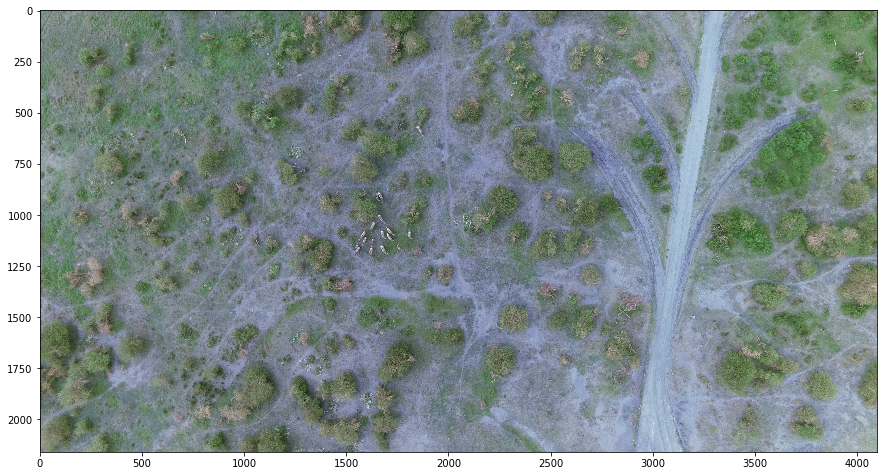

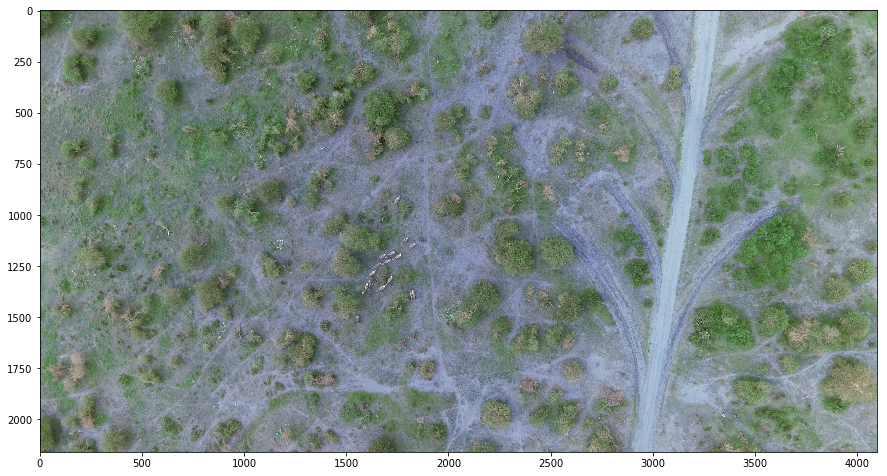

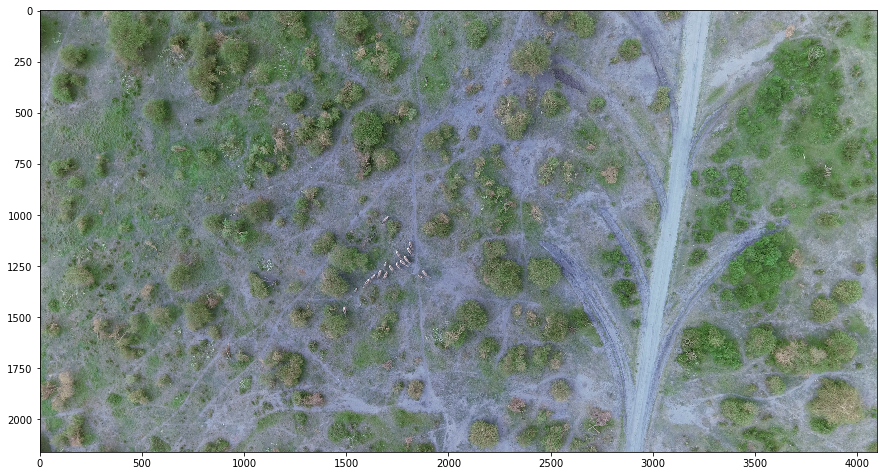

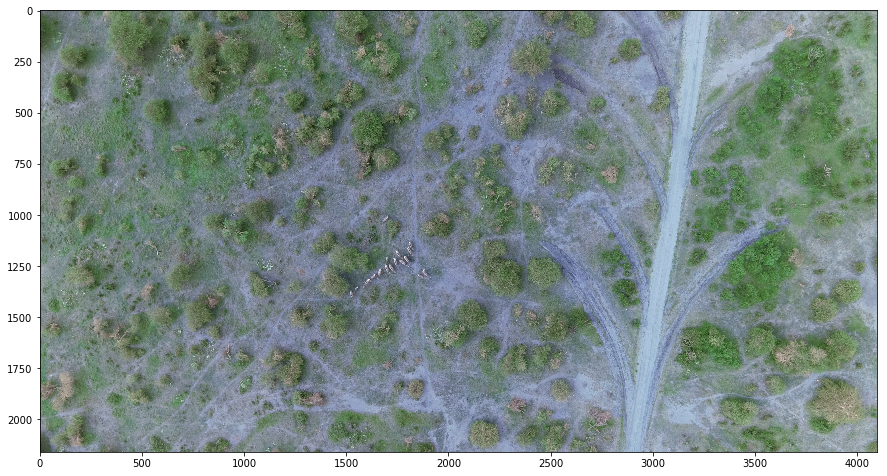

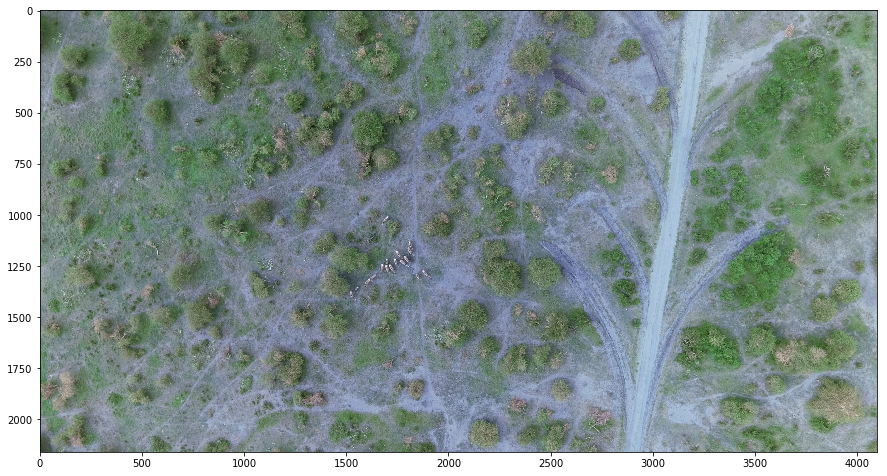

...

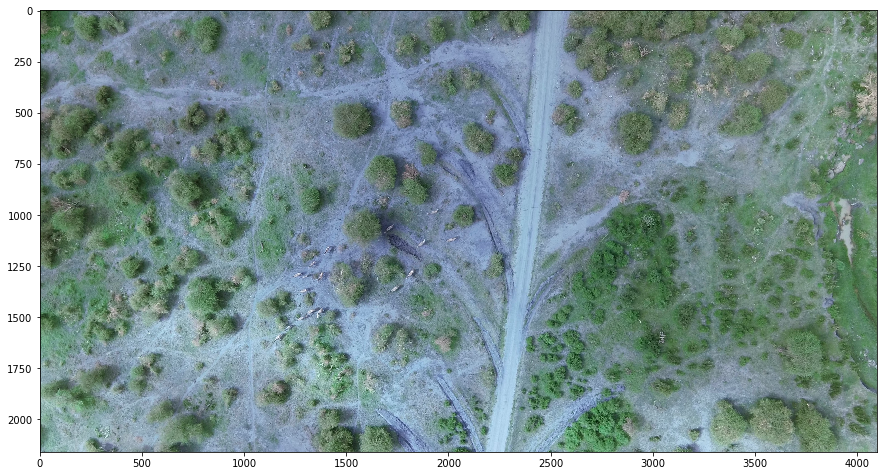

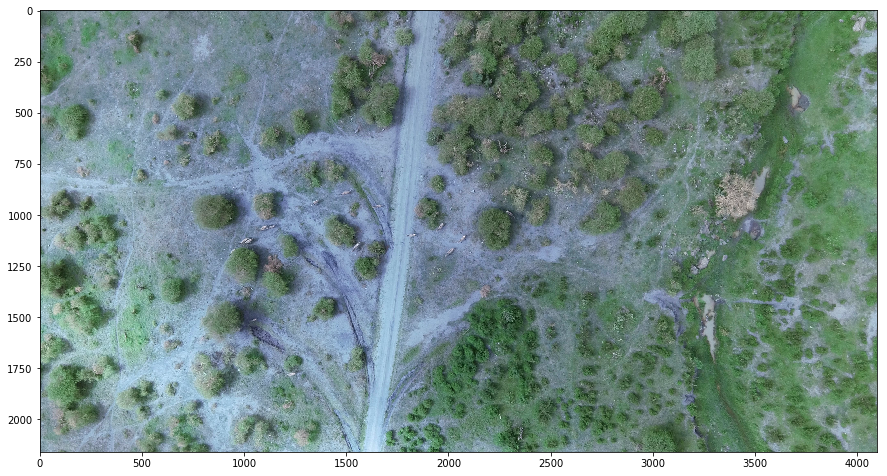

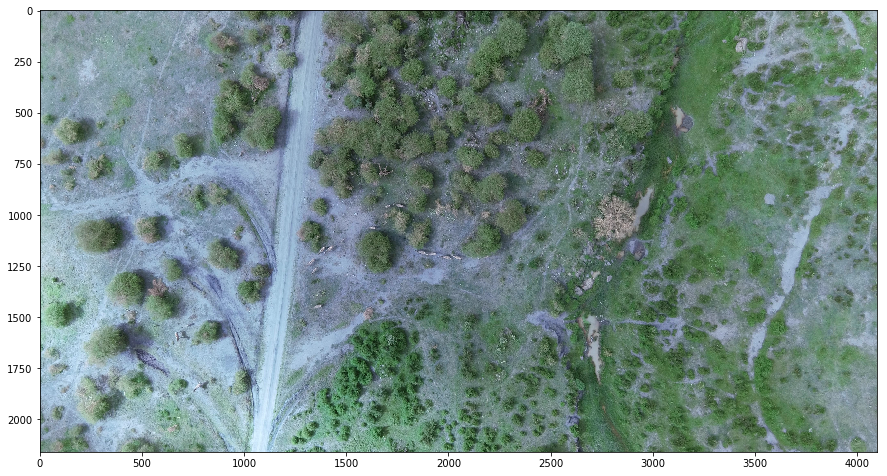

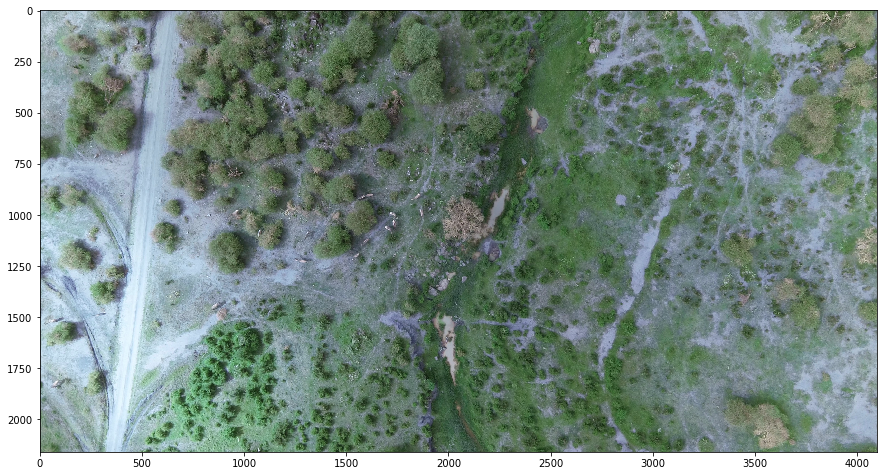

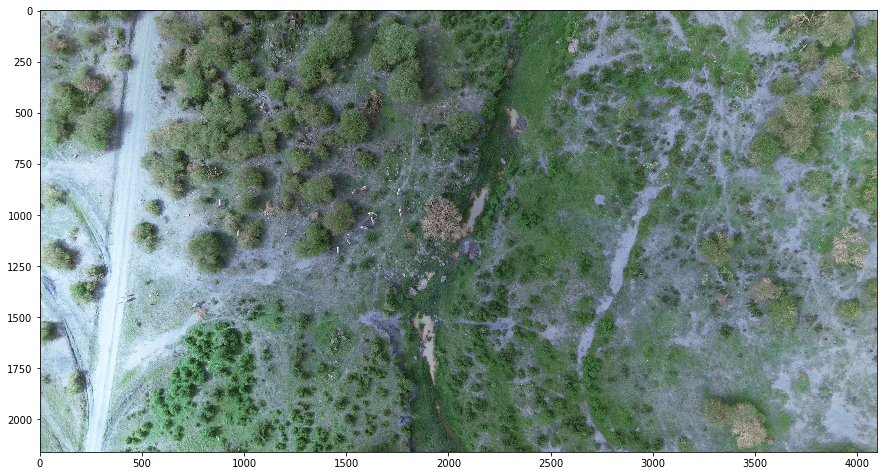

In [2]:
for frame_num in range(num_frames):
    if frame_num % 10 == 0:
        im_new = cv2.imread(image_list[-frame_num - 1], cv2.IMREAD_COLOR)
        shape = np.array(im_new.shape)
        shape = shape / im_new.shape[0] * 15
        plt.figure(figsize=(shape[0], shape[1]))
        plt.imshow(im_new)
im_new = cv2.imread(image_list[-frame_num - 1], cv2.IMREAD_COLOR)
shape = np.array(im_new.shape)
shape = shape / im_new.shape[0] * 15
plt.figure(figsize=(shape[0], shape[1]))
plt.imshow(im_new)

In [10]:
frame_num = 125
im = cv2.imread(image_list[num_frames - 1], cv2.IMREAD_COLOR)
print(im.shape)
for frame_num in range(num_frames - 1):
    im_new = cv2.imread(image_list[-frame_num - 1], cv2.IMREAD_COLOR)
    
    h = homographies[-frame_num -1]
    
    reverse_h = np.eye(3)
    for count in range(frame_num+1):
        reverse_h = np.matmul(reverse_h, homographies[-frame_num - 1 + count])

    
    h_r = reverse_h
    
    if h[1,2] < 0:
        h0 = -h[1,2]
    else:
        h0 = 0
    if h[0,2] < 0:
        h1 = -h[0,2]
    else:
        h1 = 0

    image_shape = (int(np.ceil(im_new.shape[0] + np.abs(h_r[1,2]) + 1000)), int(np.ceil(im_new.shape[1] + np.abs(h_r[0,2]))))
#     image_shape = (int(np.ceil(im_new.shape[0] + h0)), int(np.ceil(im_new.shape[1] + h1)))
#     image_shape = im.shape

    no_trans = np.copy(h)
    if no_trans[0,2] > 0:
        no_trans[0,2] = -no_trans[0,2]
    else:
        no_trans[0,2] = 0
    if no_trans[1,2] > 0:
        no_trans[1,2] = -no_trans[1,2]
    else:
        no_trans[1,2] = 0

    im = cv2.warpPerspective(im, no_trans, (image_shape[1], image_shape[0]), borderValue=[127, 127, 127])
    if (abs(int(h_r[1,2])) + im_new.shape[0]) > im.shape[0]:
        max0 = im.shape[0]
        dif0 = (abs(int(h_r[1,2])) + im_new.shape[0]) - im.shape[0]  
    else:
        max0 = (abs(int(h_r[1,2])) + im_new.shape[0])
        dif0 = 0
    if abs(int(h_r[0,2])) + im_new.shape[1] > im.shape[1]:
        max1 = im.shape[1]
        dif1 = (abs(int(h_r[0,2])) + im_new.shape[1]) - im.shape[1]  
    else:
        max1 = abs(int(h_r[0,2])) + im_new.shape[1]
        dif1 = 0
        

    im[abs(int(h_r[1,2])):max0, abs(int(h_r[0,2])):max1] = im_new[dif0:,dif1:]
    im_copy = np.copy(im)
    im_copy[abs(int(h_r[1,2])):max0, abs(int(h_r[0,2])):max1] = np.zeros_like(im_new[dif0:,dif1:])
#     if dif1 != 0 or dif0 != 0:
#         print('dif1', dif1)
#         print('dif0', dif0)
    
#     if frame_num % 10 == 0:
        
#         shape = np.array(im.shape)
#         shape = shape / im.shape[0] * 30
#         plt.figure(figsize=(shape[0], shape[1]))
#         plt.imshow(im)


(2160, 4096, 3)


In [11]:
print(h)

[[ 9.99540493e-01  1.56778800e-04  5.62838534e-01]
 [-6.03973873e-05  9.99923298e-01  8.26360497e-02]
 [-1.00131845e-07  8.72491412e-08  1.00000000e+00]]


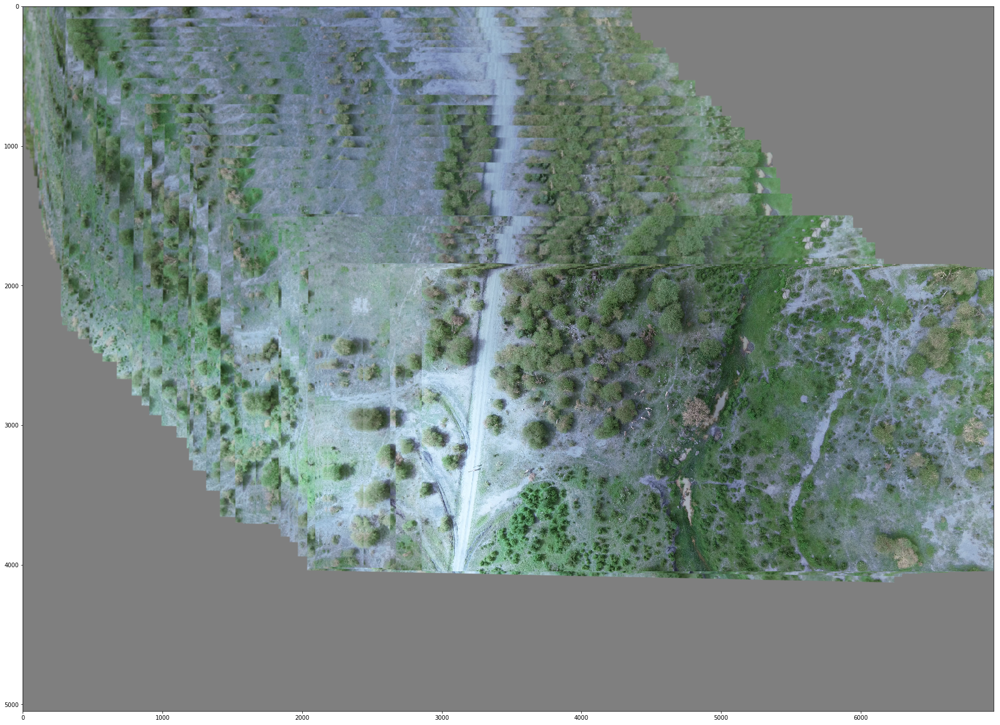

In [12]:
shape = np.array(im.shape)
shape = shape / im.shape[0] * 30
plt.figure(figsize=(shape[0], shape[1]))
plt.imshow(im)
